In [2]:
import zipfile
import fnmatch
import os
import pandas as pd
import pyarrow as pa
import pyarrow.parquet as pq
import folium
from IPython.display import display
import matplotlib.pyplot as plt

In [15]:
parquet_file = r"C:\Users\bella\Downloads\Y2Q4 JBG050 Data Challenge 2\clean_df.parquet"
dataset = pd.read_parquet(parquet_file, engine='pyarrow')
pd.options.display.max_columns = None
# print(dataset)

                                                   Crime ID    Month  \
2051                                                   None  2010-12   
2052                                                   None  2010-12   
2053                                                   None  2010-12   
2054                                                   None  2010-12   
2071                                                   None  2010-12   
...                                                     ...      ...   
13079989  fda0870be993d2c9352ae14a540bf529c15a7aa9d92a4e...  2023-03   
13079990  c6c2d9a772695865f4ca33fce59c26c48fe3a1cdac8c22...  2023-03   
13080002  e5bab2bd4f31de44515dbf125b85284392d0349139a1d3...  2023-03   
13080003  823465427f8764e250a48312715a4bd87e8012412046c6...  2023-03   
13080004  50b5bbf4987109ee189f8a736ec7e92365b25169b7f783...  2023-03   

                          Reported by                 Falls within  Longitude  \
2051      Metropolitan Police Service  Metropolitan Po

<BarContainer object of 14 artists>

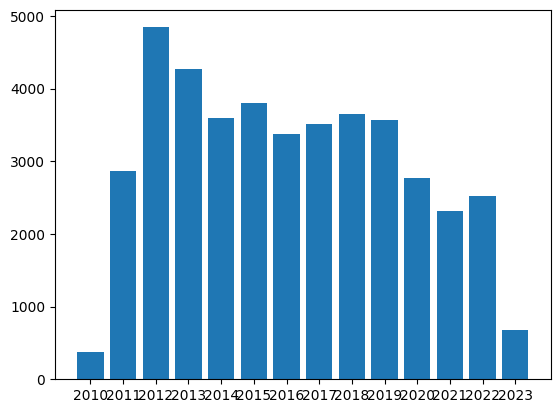

In [4]:
year = dataset.groupby(dataset['Month'].str[:4])
year_count = year['Reported by'].count()
plt.bar(year_count.index, year_count.values)

<BarContainer object of 12 artists>

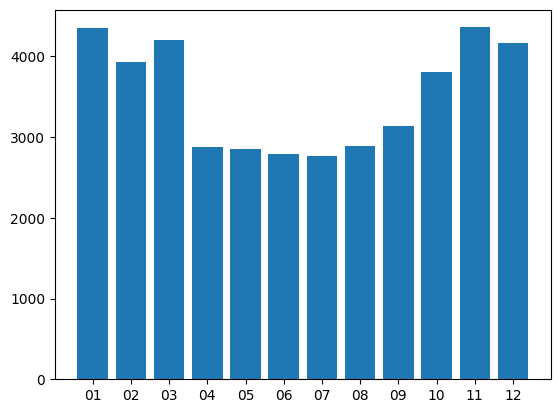

In [7]:
month = dataset.groupby(dataset['Month'].str[-2:])
month_count = month['Reported by'].count()
plt.bar(month_count.index, month_count.values)

In [8]:
locations = list(zip(dataset.Latitude, dataset.Longitude))

m = folium.Map(location= [51.5074, -0.1278],width="%100",height="%100")
for i in range(len(locations)):
    folium.CircleMarker(location=locations[i],radius=1).add_to(m)
m